<img src="http://imgur.com/1ZcRyrc.png" style="float: left; margin: 20px; height: 55px">

# Capstone Project: Predicting Fentanyl Presence In <br> Accidental Drug Overdose Deaths In Connecticut, USA

### Contents:
#### Part 3 (of 5)
- Keywords
- Background
- Problem Statement
- Target Audience
- Objectives
- Data Wrangling
- [Exploration & Visualisation](#Exploration-&-Visualisation)
- Pre-Processing & Modelling
- Results & Discussion
- Recommendations
- Conclusion
- References

## Exploration & Visualisation

### Import Libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import json
import geopandas

import folium
from folium.plugins import TimeSliderChoropleth
from folium.plugins import TimestampedGeoJson

pd.set_option('display.max.columns', None)
pd.set_option('display.max.colwidth', 100)

### Import DataFrame

In [2]:
# read in dataset
df = pd.read_csv('../data/accidental_drug_related_deaths_2012_2020_clean.csv')

### Glimpse DataFrame

In [3]:
# check out dataset
df.head()

,Date,Age,Sex,Race,Death_County,Death_City,Death_City_Geo,Death_Place,Injury_Place,Fentanyl,Any_Fentanyl_Analogue,Buprenorphine,Methadone,Oxymorphone,Hydromorphone,Oxycodone,Hydrocodone,Heroin,Morphine_Not_Heroin,Tramadol,Codeine,Ethanol,Cocaine,Xylazine,Phencyclidine,Any_Benzodiazepine,Any_Amphetamine,Other_Drug,Any_Opioid,Other_Opioid,Covid_Pandemic,Num_Drugs,Num_Conditions
0,2012-01-01,35,Male,White,TOLLAND,HEBRON,"HEBRON, CT\n(41.658069, -72.366324)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,Y,N,N,N,N,N,Y,N,N,2,0
1,2012-01-03,41,Male,White,HARTFORD,BRISTOL,"BRISTOL, CT\n(41.673037, -72.945791)",Hospital,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,Y,N,N,Y,N,N,1,0
2,2012-01-04,61,Male,Black,FAIRFIELD,DANBURY,"DANBURY, CT\n(41.393666, -73.451539)",Hospital,Other,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,1,0
3,2012-01-05,51,Male,White,FAIRFIELD,BRIDGEPORT,"BRIDGEPORT, CT\n(41.179195, -73.189476)",Other,Residence,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0
4,2012-01-07,45,Male,White,HARTFORD,HARTFORD,"HARTFORD, CT\n(41.765775, -72.673356)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0


### Descriptive Statistics

In [4]:
# generate descriptive statistics for numerical columns
df.describe()

,Age,Num_Drugs,Num_Conditions
count,7646.000000,7646.000000,7646.000000
mean,42.467042,2.856657,0.111431
std,12.469889,1.624651,0.418515
min,14.000000,1.000000,0.000000
25%,32.000000,2.000000,0.000000
50%,42.000000,3.000000,0.000000
75%,53.000000,4.000000,0.000000
max,87.000000,13.000000,4.000000


In [5]:
# generate descriptive statistics for categorical columns
df.drop(columns=['Date', 'Death_City_Geo']).describe(include='object')

,Sex,Race,Death_County,Death_City,Death_Place,Injury_Place,Fentanyl,Any_Fentanyl_Analogue,Buprenorphine,Methadone,Oxymorphone,Hydromorphone,Oxycodone,Hydrocodone,Heroin,Morphine_Not_Heroin,Tramadol,Codeine,Ethanol,Cocaine,Xylazine,Phencyclidine,Any_Benzodiazepine,Any_Amphetamine,Other_Drug,Any_Opioid,Other_Opioid,Covid_Pandemic
count,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646,7646
unique,2,5,8,223,7,7,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2,2
top,Male,White,HARTFORD,HARTFORD,Residence,Residence,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N
freq,5696,5804,2344,890,4029,5895,4358,6933,7462,6953,7497,7531,6846,7502,4469,7294,7412,7605,5627,5122,7437,7494,5709,7319,7078,7033,7563,6513


### Time Series Visualisations

In [6]:
# create a datetime column from the date column
df['Datetime'] = pd.to_datetime(df['Date'])

In [7]:
# generate count of total deaths and fentanyl deaths by year
total_yearly_deaths = df.groupby(df['Datetime'].dt.year).count()['Date']
fentanyl_yearly_deaths = df[df['Fentanyl'] == 'Y'].groupby(df['Datetime'].dt.year).count()['Date']
pd.DataFrame({'Year': total_yearly_deaths.index, 
              'Total Deaths': total_yearly_deaths.values, 
              'Fentanyl Deaths': fentanyl_yearly_deaths.values, 
              'Fentanyl Deaths / Total Deaths': fentanyl_yearly_deaths.values / total_yearly_deaths.values})

,Year,Total Deaths,Fentanyl Deaths,Fentanyl Deaths / Total Deaths
0,2012,355,15,0.042254
1,2013,490,38,0.077551
2,2014,555,76,0.136937
3,2015,726,188,0.258953
4,2016,913,485,0.531216
5,2017,1035,674,0.651208
6,2018,1013,757,0.747285
7,2019,1193,973,0.815591
8,2020,1366,1152,0.843338


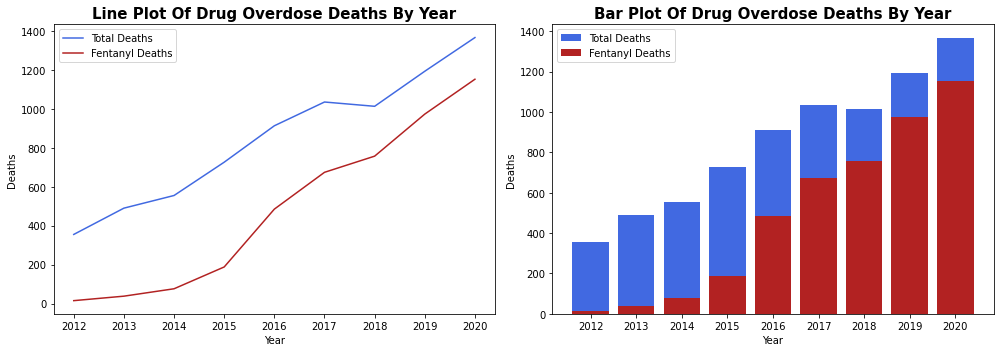

In [8]:
# visualise line plot and bar plot of total deaths and fentanyl deaths by year
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
sns.lineplot(data=total_yearly_deaths, label='Total Deaths', color='royalblue')
sns.lineplot(data=fentanyl_yearly_deaths, label='Fentanyl Deaths', color='firebrick')
plt.title('Line Plot Of Drug Overdose Deaths By Year', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Year')
plt.legend()

plt.subplot(1, 2, 2)
plt.bar(x=total_yearly_deaths.index, height=total_yearly_deaths.values, label='Total Deaths', color='royalblue')
plt.bar(x=total_yearly_deaths.index, height=fentanyl_yearly_deaths.values, label='Fentanyl Deaths', color='firebrick')
plt.title('Bar Plot Of Drug Overdose Deaths By Year', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Year')
plt.xticks(total_yearly_deaths.index)
plt.legend()

plt.tight_layout();

# save plot
plt.savefig('../plots/total_deaths_and_fentanyl_deaths_by_year.png', 
            dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** An increasing trend in both total deaths (overdose deaths caused by any drug) and fentanyl deaths (overdose deaths that contained fentanyl) is seen from 2012 to 2020. However, the number of fentanyl deaths has been increasing much faster than the number of total deaths, which explains fentanyl's mounting share of the total deaths. In 2012, fentanyl deaths made up just 4.2% of total deaths. By 2020, fentanyl deaths have made up 84.3% of total deaths. The role of fentanyl in the deaths of accidental drug overdose victims has surged 80.1% over a period of 9 years.

In [9]:
# generate count of deaths caused by fentanyl and rest of the drugs by year
all_drugs = list(df.loc[:, 'Fentanyl': 'Other_Drug'].columns) + ['Other_Opioid']

all_drugs_yearly_deaths = pd.DataFrame(index=[2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020])

for x in all_drugs:
    
    yearly_deaths = df[df[x] == 'Y'].groupby(df['Datetime'].dt.year).count()['Date'].to_frame(x + ' Deaths')
    all_drugs_yearly_deaths = pd.merge(all_drugs_yearly_deaths, yearly_deaths, 
                                       how='outer', left_index=True, right_index=True)

all_drugs_yearly_deaths.fillna(0).astype('int').reset_index().rename(columns={'index': 'Year'})

,Year,Fentanyl Deaths,Any_Fentanyl_Analogue Deaths,Buprenorphine Deaths,Methadone Deaths,Oxymorphone Deaths,Hydromorphone Deaths,Oxycodone Deaths,Hydrocodone Deaths,Heroin Deaths,Morphine_Not_Heroin Deaths,Tramadol Deaths,Codeine Deaths,Ethanol Deaths,Cocaine Deaths,Xylazine Deaths,Phencyclidine Deaths,Any_Benzodiazepine Deaths,Any_Amphetamine Deaths,Other_Drug Deaths,Other_Opioid Deaths
0,2012,15,0,0,35,30,1,70,15,174,17,8,1,62,109,0,3,49,7,39,8
1,2013,38,0,3,47,16,5,74,19,257,31,8,6,89,150,0,9,80,4,48,5
2,2014,76,0,5,55,31,11,103,13,330,26,15,0,134,131,0,5,156,13,60,3
3,2015,188,13,13,75,10,21,97,20,417,35,19,4,186,179,0,8,221,21,76,7
4,2016,485,62,26,86,7,24,111,22,492,55,19,9,260,277,0,15,244,20,76,17
5,2017,674,147,20,99,8,19,95,15,473,45,28,0,290,345,0,14,329,40,66,11
6,2018,757,258,27,86,16,8,61,14,388,41,38,5,254,344,0,19,265,56,67,9
7,2019,973,147,40,92,20,14,94,13,385,37,36,8,342,461,70,27,290,71,136,10
8,2020,1152,86,50,118,11,12,95,13,261,65,63,8,402,528,139,52,303,95,0,13


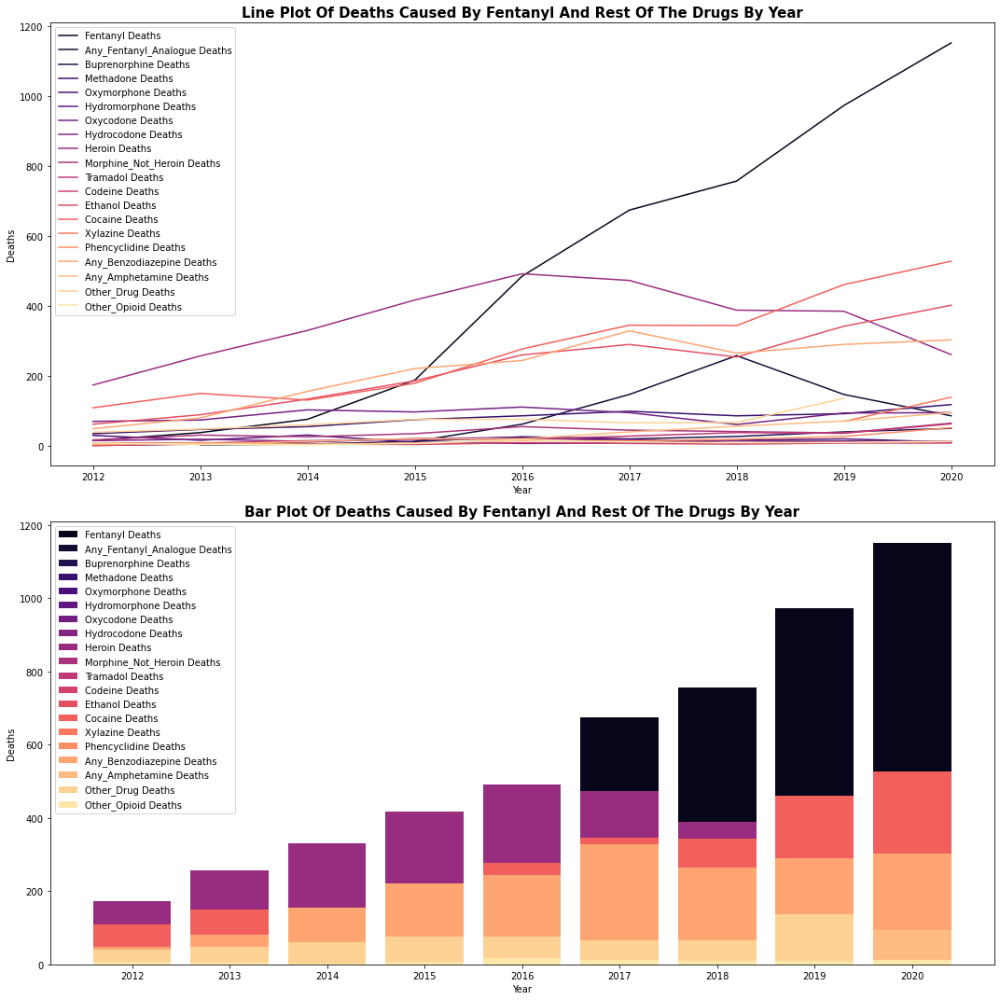

In [10]:
# visualise line plot and bar plot of deaths caused by fentanyl and rest of the drugs by year
all_drugs = list(df.loc[:, 'Fentanyl': 'Other_Drug'].columns) + ['Other_Opioid']
color_palette = sns.color_palette('magma', len(all_drugs))

plt.figure(figsize=(15, 15))

plt.subplot(2, 1, 1)
for x in all_drugs:
    
    yearly_deaths = df[df[x] == 'Y'].groupby(df['Datetime'].dt.year).count()['Date']
    sns.lineplot(data=yearly_deaths, label=x + ' Deaths', color=color_palette[all_drugs.index(x)])

plt.title('Line Plot Of Deaths Caused By Fentanyl And Rest Of The Drugs By Year', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Year')
plt.legend()

plt.subplot(2, 1, 2)
for x in all_drugs:
    
    yearly_deaths = df[df[x] == 'Y'].groupby(df['Datetime'].dt.year).count()['Date']
    plt.bar(x=yearly_deaths.index, height=yearly_deaths.values, label=x + ' Deaths', 
            color=color_palette[all_drugs.index(x)])

plt.title('Bar Plot Of Deaths Caused By Fentanyl And Rest Of The Drugs By Year', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Year')
plt.xticks(yearly_deaths.index)
plt.legend()

plt.tight_layout();

# save plot
plt.savefig('../plots/fentanyl_deaths_and_rest_of_the_drugs_deaths_by_year.png', 
            dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Before 2016, heroin was the number one drug in terms of number of deaths each year. In 2016, heroin and fentanyl had roughly the same number of deaths. After 2016, fentanyl surpassed heroin to become the number one drug in terms of number of deaths each year.

### Geographical Map Visualisations: Choropleth Maps (County Level Data)

#### Pre-Processing For Choropleth Maps

In [11]:
# look inside connecticut counties json file
data = json.load(open('../data/connecticut_counties.json'))
data

{'type': 'FeatureCollection',
 'name': 'CT_County_Index',
 'crs': {'type': 'name',
  'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'}},
 'features': [{'type': 'Feature',
   'properties': {'OBJECTID': 1,
    'FIPS_COD': '09001',
    'CNTY_NO': 1,
    'CNTY_COD': 1,
    'COUNTY': 'Fairfield',
    'SHAPE_Length': 3.3593117291170174,
    'SHAPE_Area': 0.1794571439086765},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[-73.50659983999998, 41.66567354700004],
       [-73.50662981299996, 41.66522360400006],
       [-73.50673220699997, 41.66488313700006],
       [-73.50676195999995, 41.66466921800003],
       [-73.50685771099995, 41.66423016400006],
       [-73.50685743799994, 41.66410906700003],
       [-73.50675531399997, 41.66384541200006],
       [-73.50666785999994, 41.66374135400008],
       [-73.50638267499994, 41.663471869000034],
       [-73.50614834199996, 41.66334562000003],
       [-73.50601634999998, 41.663247],
       [-73.50556279099999, 41.662955803000045

In [12]:
# read in connecticut counties json file as a dataframe
counties_geojson = geopandas.read_file('../data/connecticut_counties.json')
counties_geojson

,OBJECTID,FIPS_COD,CNTY_NO,CNTY_COD,COUNTY,SHAPE_Length,SHAPE_Area,geometry
0,1,09001,1,1,Fairfield,3.359312,0.179457,"MULTIPOLYGON (((-73.50660 41.66567, -73.50663 41.66522, -73.50673 41.66488, -73.50676 41.66467, ..."
1,2,09003,2,3,Hartford,2.646508,0.210661,"MULTIPOLYGON (((-73.00869 42.03880, -73.00307 42.03865, -73.00021 42.03860, -72.99955 42.03860, ..."
2,3,09005,3,5,Litchfield,2.413699,0.265099,"MULTIPOLYGON (((-73.23289 42.04502, -73.23165 42.04499, -73.22852 42.04493, -73.22415 42.04481, ..."
3,4,09007,4,7,Middlesex,1.990032,0.107218,"MULTIPOLYGON (((-72.54456 41.64275, -72.50582 41.64720, -72.50561 41.64689, -72.50548 41.64672, ..."
4,5,09009,5,9,New Haven,3.083313,0.172336,"MULTIPOLYGON (((-72.93826 41.64412, -72.93800 41.64056, -72.93759 41.63690, -72.93709 41.63293, ..."
5,6,09011,6,11,New London,3.044883,0.192584,"MULTIPOLYGON (((-72.15790 41.65775, -72.15609 41.66119, -72.15496 41.66340, -72.15487 41.66349, ..."
6,7,09013,7,13,Tolland,1.877277,0.117180,"MULTIPOLYGON (((-72.50930 42.03435, -72.50087 42.03429, -72.49962 42.03431, -72.49953 42.03425, ..."
7,8,09015,8,15,Windham,1.779004,0.146365,"MULTIPOLYGON (((-72.10212 42.02885, -72.09983 42.02879, -72.09979 42.02879, -72.09472 42.02857, ..."


#### Choropleth Map: Count Of Drug Overdose Deaths In Connecticut Counties All-In-All From 2012 To 2020

In [13]:
# make county column in counties_geojson uppercase to help Choropleth with matching
counties_geojson['COUNTY'] = counties_geojson['COUNTY'].apply(lambda x: x.upper())
counties_geojson

,OBJECTID,FIPS_COD,CNTY_NO,CNTY_COD,COUNTY,SHAPE_Length,SHAPE_Area,geometry
0,1,09001,1,1,FAIRFIELD,3.359312,0.179457,"MULTIPOLYGON (((-73.50660 41.66567, -73.50663 41.66522, -73.50673 41.66488, -73.50676 41.66467, ..."
1,2,09003,2,3,HARTFORD,2.646508,0.210661,"MULTIPOLYGON (((-73.00869 42.03880, -73.00307 42.03865, -73.00021 42.03860, -72.99955 42.03860, ..."
2,3,09005,3,5,LITCHFIELD,2.413699,0.265099,"MULTIPOLYGON (((-73.23289 42.04502, -73.23165 42.04499, -73.22852 42.04493, -73.22415 42.04481, ..."
3,4,09007,4,7,MIDDLESEX,1.990032,0.107218,"MULTIPOLYGON (((-72.54456 41.64275, -72.50582 41.64720, -72.50561 41.64689, -72.50548 41.64672, ..."
4,5,09009,5,9,NEW HAVEN,3.083313,0.172336,"MULTIPOLYGON (((-72.93826 41.64412, -72.93800 41.64056, -72.93759 41.63690, -72.93709 41.63293, ..."
5,6,09011,6,11,NEW LONDON,3.044883,0.192584,"MULTIPOLYGON (((-72.15790 41.65775, -72.15609 41.66119, -72.15496 41.66340, -72.15487 41.66349, ..."
6,7,09013,7,13,TOLLAND,1.877277,0.117180,"MULTIPOLYGON (((-72.50930 42.03435, -72.50087 42.03429, -72.49962 42.03431, -72.49953 42.03425, ..."
7,8,09015,8,15,WINDHAM,1.779004,0.146365,"MULTIPOLYGON (((-72.10212 42.02885, -72.09983 42.02879, -72.09979 42.02879, -72.09472 42.02857, ..."


In [14]:
# make a dataframe of the total death count in each county all-in-all from 2012 to 2020
county_deaths = pd.DataFrame({'Death_County': df.groupby('Death_County').count()['Date'].index, 
                              'Total_Death_Count': df.groupby('Death_County').count()['Date'].values})
county_deaths

,Death_County,Total_Death_Count
0,FAIRFIELD,1222
1,HARTFORD,2344
2,LITCHFIELD,404
3,MIDDLESEX,313
4,NEW HAVEN,2185
5,NEW LONDON,692
6,TOLLAND,208
7,WINDHAM,278


In [15]:
# add total_death_count column in county_deaths to counties_geojson to display in tooltip to choropleth map
counties_geojson['TOTAL_DEATH_COUNT'] = county_deaths['Total_Death_Count']

In [16]:
# visualise the total death count in each county all-in-all from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# add choropleth to the map
folium.Choropleth(
    geo_data=counties_geojson, 
    data=county_deaths, 
    columns=['Death_County', 'Total_Death_Count'], 
    key_on='feature.properties.COUNTY', 
    fill_color='Blues', fill_opacity=0.7, 
    line_color='white', line_opacity=0.7, line_weight=2, 
    bins=[0, 500, 1000, 1500, 2000, 2500], 
    name='County Total Deaths', 
    legend_name='Total Death Count' 
).add_to(m)

# add layer control to the map
folium.LayerControl(collapsed=False).add_to(m)

# create a style_function for GeoJson
style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}

# create a highlight_function for GeoJson
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

# add tooltip to the map
folium.GeoJson(
    data=counties_geojson, 
    tooltip=folium.GeoJsonTooltip(fields=['COUNTY', 'TOTAL_DEATH_COUNT'], aliases=['County:', 'Total Deaths:']), 
    style_function=style_function, 
    highlight_function=highlight_function, 
    control=False
).add_to(m)

# save map
m.save('../maps/choropleth_map_total_deaths_all_years.html')

# show map
m

**Interpretation:** From 2012 to 2020, Hartford County recorded the highest number of drug overdose deaths at 2344 whereas Tolland County recorded the lowest number of drug overdose deaths at 208. This represents a more than 10-fold difference in the severity of the drug overdose crisis impacting the most-affected county and the least-affected county. Drug overdose deaths are the most prevalent in Hartford County (where Hartford City, the capital of Connecticut, is located) and the least prevalent in Tolland County.

In [17]:
# make a dataframe of the fentanyl death count in each county all-in-all from 2012 to 2020
county_deaths = pd.DataFrame({'Death_County': df[df['Fentanyl'] == 'Y'].groupby('Death_County')\
                              .count()['Date'].index, 
                              'Fentanyl_Death_Count': df[df['Fentanyl'] == 'Y'].groupby('Death_County')\
                              .count()['Date'].values})
county_deaths

,Death_County,Fentanyl_Death_Count
0,FAIRFIELD,666
1,HARTFORD,1450
2,LITCHFIELD,222
3,MIDDLESEX,169
4,NEW HAVEN,1172
5,NEW LONDON,386
6,TOLLAND,125
7,WINDHAM,168


In [18]:
# add fentanyl_death_count column in county_deaths to counties_geojson to display in tooltip to choropleth map
counties_geojson['FENTANYL_DEATH_COUNT'] = county_deaths['Fentanyl_Death_Count']

In [19]:
# visualise the fentanyl death count in each county all-in-all from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# add choropleth to the map
folium.Choropleth(
    geo_data=counties_geojson, 
    data=county_deaths, 
    columns=['Death_County', 'Fentanyl_Death_Count'], 
    key_on='feature.properties.COUNTY', 
    fill_color='Reds', fill_opacity=0.7, 
    line_color='white', line_opacity=0.7, line_weight=2, 
    bins=[0, 250, 500, 750, 1000, 1250, 1500], 
    name='County Fentanyl Deaths', 
    legend_name='Fentanyl Death Count' 
).add_to(m)

# add layer control to the map
folium.LayerControl(collapsed=False).add_to(m)

# create a style_function for GeoJson
style_function = lambda x: {'fillColor': '#ffffff', 'color':'#000000', 'fillOpacity': 0.1, 'weight': 0.1}

# create a highlight_function for GeoJson
highlight_function = lambda x: {'fillColor': '#000000', 'color':'#000000', 'fillOpacity': 0.50, 'weight': 0.1}

# add tooltip to the map
folium.GeoJson(
    data=counties_geojson, 
    tooltip=folium.GeoJsonTooltip(fields=['COUNTY', 'FENTANYL_DEATH_COUNT'], aliases=['County:', 'Fentanyl Deaths:']), 
    style_function=style_function, 
    highlight_function=highlight_function, 
    control=False
).add_to(m)

# save map
m.save('../maps/choropleth_map_fentanyl_deaths_all_years.html')

# show map
m

**Interpretation:** From 2012 to 2020, Hartford County recorded the highest number of fentanyl deaths at 1450 whereas Tolland County recorded the lowest number of fentanyl deaths at 125. This represents a more than 10-fold difference in the severity of the fentanyl crisis impacting the most-affected county and the least-affected county. Fentanyl deaths are the most prevalent in Hartford County (where Hartford City, the capital of Connecticut, is located) and the least prevalent in Tolland County.

#### Choropleth Map: Count Of Drug Overdose Deaths In Connecticut Counties Year-By-Year From 2012 To 2020

In [20]:
# create a column to group all deaths in the same year under one date category
df['Year_End'] = df['Date'].apply(lambda x: x[:4] + '-12-31')
df.head()

,Date,Age,Sex,Race,Death_County,Death_City,Death_City_Geo,Death_Place,Injury_Place,Fentanyl,Any_Fentanyl_Analogue,Buprenorphine,Methadone,Oxymorphone,Hydromorphone,Oxycodone,Hydrocodone,Heroin,Morphine_Not_Heroin,Tramadol,Codeine,Ethanol,Cocaine,Xylazine,Phencyclidine,Any_Benzodiazepine,Any_Amphetamine,Other_Drug,Any_Opioid,Other_Opioid,Covid_Pandemic,Num_Drugs,Num_Conditions,Datetime,Year_End
0,2012-01-01,35,Male,White,TOLLAND,HEBRON,"HEBRON, CT\n(41.658069, -72.366324)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,Y,N,N,N,N,N,Y,N,N,2,0,2012-01-01,2012-12-31
1,2012-01-03,41,Male,White,HARTFORD,BRISTOL,"BRISTOL, CT\n(41.673037, -72.945791)",Hospital,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,Y,N,N,Y,N,N,1,0,2012-01-03,2012-12-31
2,2012-01-04,61,Male,Black,FAIRFIELD,DANBURY,"DANBURY, CT\n(41.393666, -73.451539)",Hospital,Other,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,1,0,2012-01-04,2012-12-31
3,2012-01-05,51,Male,White,FAIRFIELD,BRIDGEPORT,"BRIDGEPORT, CT\n(41.179195, -73.189476)",Other,Residence,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0,2012-01-05,2012-12-31
4,2012-01-07,45,Male,White,HARTFORD,HARTFORD,"HARTFORD, CT\n(41.765775, -72.673356)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0,2012-01-07,2012-12-31


In [21]:
# replace the space in county names with an underscore to help TimeSliderChoropleth with matching
counties_geojson['COUNTY'] = counties_geojson['COUNTY'].apply(lambda x: x.replace(' ', '_'))

In [22]:
# make a dataframe of the total death count in each county year-by-year from 2012 to 2020
county_deaths = df.groupby(['Year_End', 'Death_County'], as_index=False).count()[['Year_End', 'Death_County', 'Date']]
county_deaths.columns = ['Year_End', 'Death_County', 'Total_Death_Count']
county_deaths

,Year_End,Death_County,Total_Death_Count
0,2012-12-31,FAIRFIELD,52
1,2012-12-31,HARTFORD,101
2,2012-12-31,LITCHFIELD,17
3,2012-12-31,MIDDLESEX,19
4,2012-12-31,NEW HAVEN,99
...,...,...,...
67,2020-12-31,MIDDLESEX,59
68,2020-12-31,NEW HAVEN,419
69,2020-12-31,NEW LONDON,111
70,2020-12-31,TOLLAND,32


In [23]:
# divide the range between the min and max death counts into 10 equal bins for assignment of opacity
bins = np.linspace(min(county_deaths['Total_Death_Count']), max(county_deaths['Total_Death_Count']), 11)
bins

array([  9.,  50.,  91., 132., 173., 214., 255., 296., 337., 378., 419.])

In [24]:
# assign 1 colour to all rows
# assign 1 of 10 opacities to each row based on the death count
county_deaths['color'] = '#3182bd'
county_deaths['opacity'] = pd.cut(county_deaths['Total_Death_Count'], bins, 
                                  labels=[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], include_lowest=True)
county_deaths

,Year_End,Death_County,Total_Death_Count,color,opacity
0,2012-12-31,FAIRFIELD,52,#3182bd,0.2
1,2012-12-31,HARTFORD,101,#3182bd,0.3
2,2012-12-31,LITCHFIELD,17,#3182bd,0.1
3,2012-12-31,MIDDLESEX,19,#3182bd,0.1
4,2012-12-31,NEW HAVEN,99,#3182bd,0.3
...,...,...,...,...,...
67,2020-12-31,MIDDLESEX,59,#3182bd,0.2
68,2020-12-31,NEW HAVEN,419,#3182bd,1.0
69,2020-12-31,NEW LONDON,111,#3182bd,0.3
70,2020-12-31,TOLLAND,32,#3182bd,0.1


In [25]:
# replace the space in county names with an underscore to help TimeSliderChoropleth with matching
county_deaths['Death_County'] = county_deaths['Death_County'].apply(lambda x: x.replace(' ', '_'))

In [26]:
# create a style dictionary for TimeSliderChoropleth
county_deaths['Year_End'] = pd.to_datetime(county_deaths['Year_End'])
county_deaths['Year_End'] = (county_deaths['Year_End'].astype(int) // 10**9).astype('U10')

county_deaths_dict = {}

for i in county_deaths['Death_County'].unique():
    
    county_deaths_dict[i] = {}
    
    for j in county_deaths[county_deaths['Death_County'] == i].set_index(['Death_County']).values:  
        
        county_deaths_dict[i][j[0]] = {'color': j[2], 'opacity': j[3]}

county_deaths_dict

{'FAIRFIELD': {'1356912000': {'color': '#3182bd', 'opacity': 0.2},
  '1388448000': {'color': '#3182bd', 'opacity': 0.3},
  '1419984000': {'color': '#3182bd', 'opacity': 0.2},
  '1451520000': {'color': '#3182bd', 'opacity': 0.3},
  '1483142400': {'color': '#3182bd', 'opacity': 0.4},
  '1514678400': {'color': '#3182bd', 'opacity': 0.4},
  '1546214400': {'color': '#3182bd', 'opacity': 0.4},
  '1577750400': {'color': '#3182bd', 'opacity': 0.5},
  '1609372800': {'color': '#3182bd', 'opacity': 0.6}},
 'HARTFORD': {'1356912000': {'color': '#3182bd', 'opacity': 0.3},
  '1388448000': {'color': '#3182bd', 'opacity': 0.4},
  '1419984000': {'color': '#3182bd', 'opacity': 0.4},
  '1451520000': {'color': '#3182bd', 'opacity': 0.5},
  '1483142400': {'color': '#3182bd', 'opacity': 0.7},
  '1514678400': {'color': '#3182bd', 'opacity': 0.8},
  '1546214400': {'color': '#3182bd', 'opacity': 0.8},
  '1577750400': {'color': '#3182bd', 'opacity': 0.9},
  '1609372800': {'color': '#3182bd', 'opacity': 1.0}},
 

In [27]:
# visualise the total death count in each county year-by-year from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# add time slider choropleth to the map
TimeSliderChoropleth(
    data=counties_geojson.set_index('COUNTY').to_json(), 
    styledict=county_deaths_dict, 
    name='County Total Deaths By Year'
).add_to(m)

# add legend to the map
folium.Choropleth(
    geo_data=counties_geojson, 
    data=county_deaths, 
    columns=['Death_County', 'Total_Death_Count'], 
    key_on='feature.properties.COUNTY', 
    fill_color='Blues', fill_opacity=0.0, 
    line_color='white', line_opacity=0.0, line_weight=0, 
    bins=[0, 50, 100, 150, 200, 250, 300, 350, 400, 450], 
    control=False, 
    legend_name='Total Death Count' 
).add_to(m)

# add layer control to the map
folium.LayerControl(collapsed=False).add_to(m)

# save map
m.save('../maps/choropleth_map_total_deaths_by_year.html')

# show map
m

**Interpretation:** From 2012 to 2020, all counties have been experiencing a rising trend in the number of drug overdose deaths. This shows that the drug overdose crisis has been deepening across all counties in Connecticut, albeit it being worse in some and better in others. Fairfield County experienced the biggest increase in deaths, from 52 in 2012 to 226 in 2020, a 4.34 times increase. Tolland County experienced the smallest increase in deaths, from 12 in 2012 to 32 in 2020, a 2.66 times increase. In 2012, Hartford County had the most number of deaths at 101 whereas Tolland County had the lowest at 12. By 2020, New Haven County had the most number of deaths at 419 whereas Tolland County had the lowest at 32.

In [28]:
# make a dataframe of the fentanyl death count in each county year-by-year from 2012 to 2020
county_deaths = df[df['Fentanyl'] =='Y'].groupby(['Year_End', 'Death_County'], as_index=False)\
.count()[['Year_End', 'Death_County', 'Date']]
county_deaths.columns = ['Year_End', 'Death_County', 'Fentanyl_Death_Count']
county_deaths

,Year_End,Death_County,Fentanyl_Death_Count
0,2012-12-31,FAIRFIELD,1
1,2012-12-31,HARTFORD,5
2,2012-12-31,MIDDLESEX,1
3,2012-12-31,NEW HAVEN,3
4,2012-12-31,NEW LONDON,4
...,...,...,...
65,2020-12-31,MIDDLESEX,45
66,2020-12-31,NEW HAVEN,363
67,2020-12-31,NEW LONDON,96
68,2020-12-31,TOLLAND,28


In [29]:
# add in the 2 counties that had 0 fentanyl deaths in 2012
zero_counts = pd.DataFrame({'Year_End': ['2012-12-31', '2012-12-31'], 
                            'Death_County': ['LITCHFIELD', 'TOLLAND'], 
                            'Fentanyl_Death_Count': [0, 0]})
county_deaths = pd.concat([county_deaths, zero_counts], axis=0)
county_deaths.reset_index(drop=True, inplace=True)
county_deaths

,Year_End,Death_County,Fentanyl_Death_Count
0,2012-12-31,FAIRFIELD,1
1,2012-12-31,HARTFORD,5
2,2012-12-31,MIDDLESEX,1
3,2012-12-31,NEW HAVEN,3
4,2012-12-31,NEW LONDON,4
...,...,...,...
67,2020-12-31,NEW LONDON,96
68,2020-12-31,TOLLAND,28
69,2020-12-31,WINDHAM,43
70,2012-12-31,LITCHFIELD,0


In [30]:
# divide the range between the min and max death counts into 10 equal bins for assignment of opacity
bins = np.linspace(min(county_deaths['Fentanyl_Death_Count']), max(county_deaths['Fentanyl_Death_Count']), 11)
bins

array([  0. ,  36.3,  72.6, 108.9, 145.2, 181.5, 217.8, 254.1, 290.4,
       326.7, 363. ])

In [31]:
# assign 1 colour to all rows
# assign 1 of 10 opacities to each row based on the death count
county_deaths['color'] = '#a50f15'
county_deaths['opacity'] = pd.cut(county_deaths['Fentanyl_Death_Count'], bins, 
                                  labels=[0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0], include_lowest=True)
county_deaths

,Year_End,Death_County,Fentanyl_Death_Count,color,opacity
0,2012-12-31,FAIRFIELD,1,#a50f15,0.1
1,2012-12-31,HARTFORD,5,#a50f15,0.1
2,2012-12-31,MIDDLESEX,1,#a50f15,0.1
3,2012-12-31,NEW HAVEN,3,#a50f15,0.1
4,2012-12-31,NEW LONDON,4,#a50f15,0.1
...,...,...,...,...,...
67,2020-12-31,NEW LONDON,96,#a50f15,0.3
68,2020-12-31,TOLLAND,28,#a50f15,0.1
69,2020-12-31,WINDHAM,43,#a50f15,0.2
70,2012-12-31,LITCHFIELD,0,#a50f15,0.1


In [32]:
# replace the space in county names with an underscore to help TimeSliderChoropleth with matching
county_deaths['Death_County'] = county_deaths['Death_County'].apply(lambda x: x.replace(' ', '_'))

In [33]:
# create a style dictionary for TimeSliderChoropleth
county_deaths['Year_End'] = pd.to_datetime(county_deaths['Year_End'])
county_deaths['Year_End'] = (county_deaths['Year_End'].astype(int) // 10**9).astype('U10')

county_deaths_dict = {}

for i in county_deaths['Death_County'].unique():
    
    county_deaths_dict[i] = {}
    
    for j in county_deaths[county_deaths['Death_County'] == i].set_index(['Death_County']).values:  
        
        county_deaths_dict[i][j[0]] = {'color': j[2], 'opacity': j[3]}

county_deaths_dict

{'FAIRFIELD': {'1356912000': {'color': '#a50f15', 'opacity': 0.1},
  '1388448000': {'color': '#a50f15', 'opacity': 0.1},
  '1419984000': {'color': '#a50f15', 'opacity': 0.1},
  '1451520000': {'color': '#a50f15', 'opacity': 0.1},
  '1483142400': {'color': '#a50f15', 'opacity': 0.3},
  '1514678400': {'color': '#a50f15', 'opacity': 0.4},
  '1546214400': {'color': '#a50f15', 'opacity': 0.3},
  '1577750400': {'color': '#a50f15', 'opacity': 0.4},
  '1609372800': {'color': '#a50f15', 'opacity': 0.6}},
 'HARTFORD': {'1356912000': {'color': '#a50f15', 'opacity': 0.1},
  '1388448000': {'color': '#a50f15', 'opacity': 0.1},
  '1419984000': {'color': '#a50f15', 'opacity': 0.1},
  '1451520000': {'color': '#a50f15', 'opacity': 0.2},
  '1483142400': {'color': '#a50f15', 'opacity': 0.5},
  '1514678400': {'color': '#a50f15', 'opacity': 0.7},
  '1546214400': {'color': '#a50f15', 'opacity': 0.8},
  '1577750400': {'color': '#a50f15', 'opacity': 1.0},
  '1609372800': {'color': '#a50f15', 'opacity': 1.0}},
 

In [34]:
# visualise the fentanyl death count in each county year-by-year from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# add time slider choropleth to the map
TimeSliderChoropleth(
    data=counties_geojson.set_index('COUNTY').to_json(), 
    styledict=county_deaths_dict, 
    name='County Fentanyl Deaths By Year'
).add_to(m)

# add legend to the map
folium.Choropleth(
    geo_data=counties_geojson, 
    data=county_deaths, 
    columns=['Death_County', 'Fentanyl_Death_Count'], 
    key_on='feature.properties.COUNTY', 
    fill_color='Reds', fill_opacity=0.0, 
    line_color='white', line_opacity=0.0, line_weight=0, 
    bins=[0, 50, 100, 150, 200, 250, 300, 350, 400], 
    control=False, 
    legend_name='Fentanyl Death Count' 
).add_to(m)

# add layer control to the map
folium.LayerControl(collapsed=False).add_to(m)

# save map
m.save('../maps/choropleth_map_fentanyl_deaths_by_year.html')

# show map
m

**Interpretation:** From 2012 to 2020, all counties have been experiencing a rising trend in the number of fentanyl deaths. This shows that the fentanyl crisis has been deepening across all counties in Connecticut, albeit it being worse in some and better in others. Fairfield County experienced the biggest increase in deaths, from 1 in 2012 to 187 in 2020, a 187 times increase. New London County experienced the smallest increase in deaths, from 4 in 2012 to 96 in 2020, a 24 times increase. In 2012, Hartford County had the most number of deaths at 5 whereas Litchfield County and Tolland County had no deaths. By 2020, New Haven County had the most number of deaths at 363 whereas Tolland County had the lowest at 28.

### Geographical Plot Visualisations: Point Maps (City Level Data)

#### Pre-Processing For Point Maps

In [35]:
# define a function to extract latitude and longitude from death_city_geo column
def get_lat_long(row):
    
    row['Death_City_Lat'] = float(row['Death_City_Geo'].split('\n')[1].split(',')[0][1:])
    row['Death_City_Long'] = float(row['Death_City_Geo'].split('\n')[1].split(',')[1][1:-1])
    
    return row

In [36]:
# apply the function
df = df.apply(get_lat_long, axis=1)
df.head()

,Date,Age,Sex,Race,Death_County,Death_City,Death_City_Geo,Death_Place,Injury_Place,Fentanyl,Any_Fentanyl_Analogue,Buprenorphine,Methadone,Oxymorphone,Hydromorphone,Oxycodone,Hydrocodone,Heroin,Morphine_Not_Heroin,Tramadol,Codeine,Ethanol,Cocaine,Xylazine,Phencyclidine,Any_Benzodiazepine,Any_Amphetamine,Other_Drug,Any_Opioid,Other_Opioid,Covid_Pandemic,Num_Drugs,Num_Conditions,Datetime,Year_End,Death_City_Lat,Death_City_Long
0,2012-01-01,35,Male,White,TOLLAND,HEBRON,"HEBRON, CT\n(41.658069, -72.366324)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,Y,N,N,N,N,N,Y,N,N,2,0,2012-01-01,2012-12-31,41.658069,-72.366324
1,2012-01-03,41,Male,White,HARTFORD,BRISTOL,"BRISTOL, CT\n(41.673037, -72.945791)",Hospital,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,Y,N,N,Y,N,N,1,0,2012-01-03,2012-12-31,41.673037,-72.945791
2,2012-01-04,61,Male,Black,FAIRFIELD,DANBURY,"DANBURY, CT\n(41.393666, -73.451539)",Hospital,Other,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,1,0,2012-01-04,2012-12-31,41.393666,-73.451539
3,2012-01-05,51,Male,White,FAIRFIELD,BRIDGEPORT,"BRIDGEPORT, CT\n(41.179195, -73.189476)",Other,Residence,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0,2012-01-05,2012-12-31,41.179195,-73.189476
4,2012-01-07,45,Male,White,HARTFORD,HARTFORD,"HARTFORD, CT\n(41.765775, -72.673356)",Residence,Residence,N,N,N,N,N,N,N,N,Y,N,N,N,N,N,N,N,N,N,N,Y,N,N,1,0,2012-01-07,2012-12-31,41.765775,-72.673356


#### Point Maps: Location Of Drug Overdose Deaths In Connecticut Cites Day-By-Day From 2012 To 2020

In [37]:
# visualise the locations of cities with at least 1 recorded drug death day-by-day from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY-MM-DD' so as to show daily data
features = []

for _, row in df.iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'mediumblue', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1D' which shows the features every day
# the 'duration' is set to 'P1D' which shows the features for 1 day only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1D', 
    duration='P1D', 
    date_options='YYYY-MM-DD', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_total_deaths_by_day.html')

# show map
m

In [38]:
# visualise the locations of cities with at least 1 recorded fentanyl death day-by-day from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY-MM-DD' so as to show daily data
features = []

for _, row in df[df['Fentanyl'] == 'Y'].iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'indianred', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1D' which shows the features every day
# the 'duration' is set to 'P1D' which shows the features for 1 day only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1D', 
    duration='P1D', 
    date_options='YYYY-MM-DD', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_fentanyl_deaths_by_day.html')

# show map
m

#### Point Maps: Location Of Drug Overdose Deaths In Connecticut Cites Month-By-Month From 2012 To 2020

In [39]:
# visualise the locations of cities with at least 1 recorded drug death month-by-month from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
                control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY-MM' so as to show monthly data
features = []

for _, row in df.iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'][:7], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'mediumblue', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1M' which shows the features every month
# the 'duration' is set to 'P1M' which shows the features for 1 month only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1M', 
    duration='P1M', 
    date_options='YYYY-MM', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_total_deaths_by_month.html')

# show map
m

In [40]:
# visualise the locations of cities with at least 1 recorded fentanyl death month-by-month from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
                control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY-MM' so as to show monthly data
features = []

for _, row in df[df['Fentanyl'] == 'Y'].iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'][:7], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'indianred', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1M' which shows the features every month
# the 'duration' is set to 'P1M' which shows the features for 1 month only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1M', 
    duration='P1M', 
    date_options='YYYY-MM', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_fentanyl_deaths_by_month.html')

# show map
m

#### Point Maps: Location Of Drug Overdose Deaths In Connecticut Cites Year-By-Year From 2012 To 2020

In [41]:
# visualise the locations of cities with at least 1 recorded drug death year-by-year from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY' so as to show yearly data
features = []

for _, row in df.iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'][:4], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'mediumblue', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1Y' which shows the features every year
# the 'duration' is set to 'P1Y' which shows the features for 1 year only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1Y', 
    duration='P1Y', 
    date_options='YYYY', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_total_deaths_by_year.html')

# show map
m

**Interpretation:** From 2012 to 2020, the number of cities recording at least 1 drug overdose death each year has been on the rise. In 2012, drug overdose deaths were recorded in 90 cities, which represent 40.3% of all cities. By 2020, drug overdose deaths were recorded in 132 cities, which represent 59.1% of all cities. This is an expansion of 18.8% of affected cities over a span of 9 years. It shows that the drug overdose epidemic has become more widespread across the cities in Connecticut over the years.

In [42]:
# visualise the locations of cities with at least 1 recorded fentanyl death year-by-year from 2012 to 2020

# create a map that centers on connecticut
m = folium.Map(location=[41.5, -72.6], 
               # width=1400, # height=800, 
               control_scale=True, 
               zoom_start=9, 
               tiles='cartodbpositron')

# create a list of features that turns it into a timestamped geojson to be passed into TimestampedGeoJson as data
# each feature is a row in the dataframe and represents a point in space (in connecticut) and in time (in history)
# each point is defined by the following characteristics: latitude, longitude, date, shape, color, etc
# the date that is assigned to 'time' is of the format 'YYYY' so as to show yearly data
features = []

for _, row in df[df['Fentanyl'] == 'Y'].iterrows():
    
    feature = {'type': 'Feature',
               'geometry': {'type': 'Point', 
                            'coordinates': [row['Death_City_Long'], row['Death_City_Lat']]},
               'properties': {'time': row['Date'][:4], 
                              'style': {'color': 'black', 'weight': 1, 'opacity': 0.7}, 
                              'icon': 'circle', 
                              'iconstyle': {'fillColor': 'indianred', 'fillOpacity': 0.7, 'radius': 3}}}
    
    features.append(feature)

# add the features and a time slider to the map
# the 'period' is set to 'P1Y' which shows the features every year
# the 'duration' is set to 'P1Y' which shows the features for 1 year only
# comment 'duration' out if you want the features to remain after appearing
TimestampedGeoJson(
    data={'type': 'FeatureCollection', 'features': features}, 
    period='P1Y', 
    duration='P1Y', 
    date_options='YYYY', 
    transition_time=50, 
    min_speed=1, max_speed=10, 
    loop=False, loop_button=True, 
    time_slider_drag_update=True
).add_to(m)

# save map
m.save('../maps/point_map_fentanyl_deaths_by_year.html')

# show map
m

**Interpretation:** From 2012 to 2020, the number of cities recording at least 1 fentanyl death each year has been on the rise. In 2012, fentanyl deaths were recorded in 12 cities, which represent 5.3% of all cities. By 2020, fentanyl deaths were recorded in 125 cities, which represent 56.0% of all cities. This is an expansion of 50.7% of affected cities over a span of 9 years. It shows that the fentanyl epidemic has become more widespread across the cities in Connecticut over the years.

### Target Visualisations

#### Fentanyl Presence

In [43]:
# generate count and proportion of fentanyl column
pd.DataFrame({'Fentanyl': df['Fentanyl'].value_counts().index, 
              'Count': df['Fentanyl'].value_counts().values, 
              'Proportion': df['Fentanyl'].value_counts(normalize=True).values})

,Fentanyl,Count,Proportion
0,Y,4358,0.569971
1,N,3288,0.430029


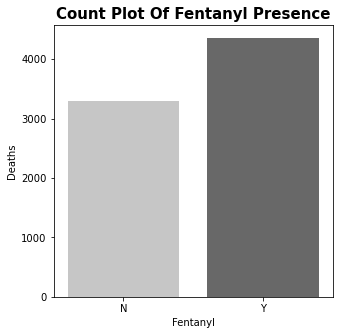

In [44]:
# visualise count plot of fentanyl column
plt.figure(figsize=(5, 5))
sns.countplot(data=df, x='Fentanyl', palette='Greys')
plt.title('Count Plot Of Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Fentanyl');

# save plot
plt.savefig('../plots/fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** There are more drug overdose deaths that had fentanyl present than absent. However, there is no gross imbalance in the two classes. The binary classes in the target column can be considered to be fairly well-balanced. There is no concern of under- or over-representation by any one class. 

### Categorical Feature Visualisations

#### Sex

In [45]:
# generate count and proportion of sex column
pd.DataFrame({'Sex': df['Sex'].value_counts().index, 
              'Count': df['Sex'].value_counts().values, 
              'Proportion': df['Sex'].value_counts(normalize=True).values})

,Sex,Count,Proportion
0,Male,5696,0.744965
1,Female,1950,0.255035


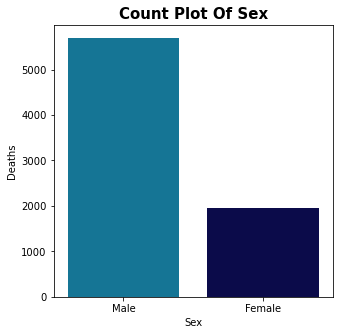

In [46]:
# visualise count plot of sex column
plt.figure(figsize=(5, 5))
sns.countplot(data=df, x='Sex', order=df['Sex'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Sex', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Sex');

# save plot
plt.savefig('../plots/sex.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** More males have died of a drug overdose than females. Males account for 74.4% of deaths while females account for 25.5% of deaths.

In [47]:
# generate count and proportion of sex column by fentanyl presence
count = df.groupby(['Sex', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Sex', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Sex    Fentanyl                   
Female N          1011    0.132226
       Y           939    0.122809
Male   N          2277    0.297803
       Y          3419    0.447162

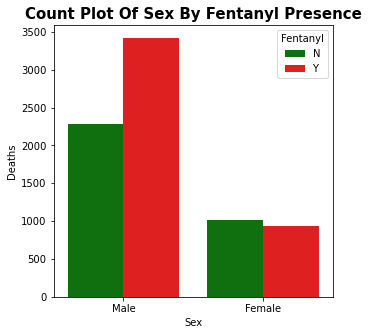

In [48]:
# visualise count plot of sex column by fentanyl presence
plt.figure(figsize=(5, 5))
sns.countplot(data=df, x='Sex', hue='Fentanyl', 
              order=df['Sex'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Sex By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Sex');

# save plot
plt.savefig('../plots/sex_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** In females, the number of fentanyl deaths and the number of non-fentanyl deaths are comparable. However, in males, the number of fentanyl deaths far outnumbers the number of non-fentanyl deaths. It appears that fentanyl use is more predominant in males than in females.

#### Race

In [49]:
# generate count and proportion of race column
pd.DataFrame({'Race': df['Race'].value_counts().index, 
              'Count': df['Race'].value_counts().values, 
              'Proportion': df['Race'].value_counts(normalize=True).values})

,Race,Count,Proportion
0,White,5804,0.759090
1,Hispanic,971,0.126995
2,Black,769,0.100575
3,Rest,56,0.007324
4,Asian,46,0.006016


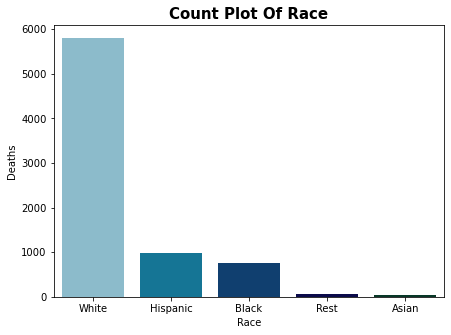

In [50]:
# visualise count plot of race column
plt.figure(figsize=(7, 5))
sns.countplot(data=df, x='Race', order=df['Race'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Race', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Race');

# save plot
plt.savefig('../plots/race.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Among all the races, the highest number of drug overdose deaths is seen in the Whites. Whites account for 75.9% of deaths. In fact, the number of Whites who died of a drug overdose is more than the number of Hispanics, Blacks, Asians, and the Rest combined.

In [51]:
# generate count and proportion of race column by fentanyl presence
count = df.groupby(['Race', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Race', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Race     Fentanyl                   
Asian    N            20    0.002616
         Y            26    0.003400
Black    N           311    0.040675
         Y           458    0.059901
Hispanic N           350    0.045776
         Y           621    0.081219
Rest     N            21    0.002747
         Y            35    0.004578
White    N          2586    0.338216
         Y          3218    0.420874

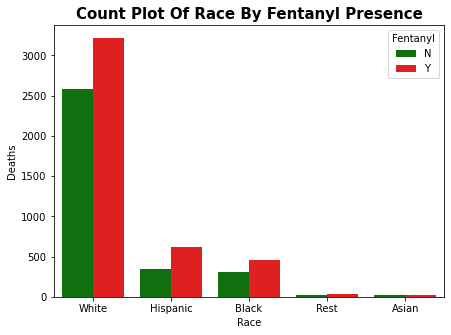

In [52]:
# visualise count plot of race column by fentanyl presence
plt.figure(figsize=(7, 5))
sns.countplot(data=df, x='Race', hue='Fentanyl', 
              order=df['Race'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Race By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Race');

# save plot
plt.savefig('../plots/race_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Across all races, a consistent trend can be seen with respect to fentanyl use. In every race, there are more deaths that involved fentanyl use than deaths that did not involve fentanyl use. Once again, the highest number of fentanyl deaths is recorded in the Whites, though this could be because the majority of drug overdose deaths is seen in the Whites to begin with. It cannot be said if fentanyl use is most predominant in one race over the others.

#### Death County

In [53]:
# generate count and proportion of death_county column
pd.DataFrame({'Death County': df['Death_County'].value_counts().index, 
              'Count': df['Death_County'].value_counts().values, 
              'Proportion': df['Death_County'].value_counts(normalize=True).values})

,Death County,Count,Proportion
0,HARTFORD,2344,0.306566
1,NEW HAVEN,2185,0.285770
2,FAIRFIELD,1222,0.159822
3,NEW LONDON,692,0.090505
4,LITCHFIELD,404,0.052838
5,MIDDLESEX,313,0.040936
6,WINDHAM,278,0.036359
7,TOLLAND,208,0.027204


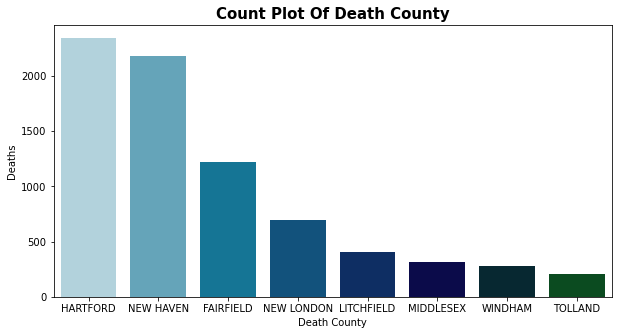

In [54]:
# visualise count plot of death_county column
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Death_County', order=df['Death_County'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Death County', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Death County');

# save plot
plt.savefig('../plots/death_county.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Of all the counties, Hartford County and New Haven County have two of the highest number of drug overdose deaths. Hartford County accounts for 30.6% of deaths while New Haven County accounts for 28.5% of deaths. Together, they account for 59.2% of deaths in Connecticut.

In [55]:
# generate count and proportion of death_county column by fentanyl presence
count = df.groupby(['Death_County', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Death_County', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Death_County Fentanyl                   
FAIRFIELD    N           556    0.072718
             Y           666    0.087104
HARTFORD     N           894    0.116924
             Y          1450    0.189642
LITCHFIELD   N           182    0.023803
             Y           222    0.029035
MIDDLESEX    N           144    0.018833
             Y           169    0.022103
NEW HAVEN    N          1013    0.132488
             Y          1172    0.153283
NEW LONDON   N           306    0.040021
             Y           386    0.050484
TOLLAND      N            83    0.010855
             Y           125    0.016348
WINDHAM      N           110    0.014387
             Y           168    0.021972

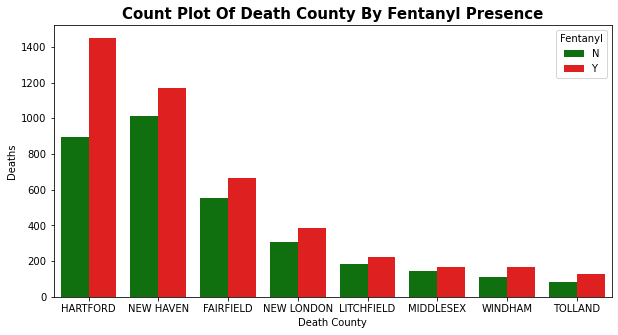

In [56]:
# visualise count plot of death_county column by fentanyl presence
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Death_County', hue='Fentanyl', 
              order=df['Death_County'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Death County By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Death County');

# save plot
plt.savefig('../plots/death_county_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Across all counties, a consistent trend can be seen with respect to fentanyl use. In every county, there are more deaths that involved fentanyl use than deaths that did not involve fentanyl use. This difference is most prominent in Hartford County, where the number of fentanyl deaths is significantly higher than the number of non-fentanyl deaths. In other counties, the number of fentanyl deaths is slightly higher than the number of non-fentanyl deaths. Once again, Hartford County and New Haven County have the two highest number of fentanyl deaths, though this could be because they have the two highest number of drug overdose deaths to begin with. 

#### Death Place

In [57]:
# generate count and proportion of death_place column
pd.DataFrame({'Death Place': df['Death_Place'].value_counts().index, 
              'Count': df['Death_Place'].value_counts().values, 
              'Proportion': df['Death_Place'].value_counts(normalize=True).values})

,Death Place,Count,Proportion
0,Residence,4029,0.526942
1,Hospital,2320,0.303427
2,Other,970,0.126864
3,Hotel/Motel,196,0.025634
4,Vehicle/Parking Lot,74,0.009678
5,Park/Street,40,0.005231
6,Unknown,17,0.002223


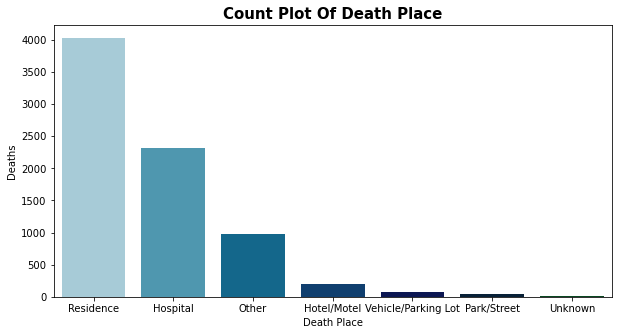

In [58]:
# visualise count plot of death_place column
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Death_Place', order=df['Death_Place'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Death Place', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Death Place');

# save plot
plt.savefig('../plots/death_place.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Most victims died of a drug overdose in their residence. Residence is the place of death for 52.6% of victims.

In [59]:
# generate count and proportion of death_place column by fentanyl presence
count = df.groupby(['Death_Place', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Death_Place', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Death_Place         Fentanyl                   
Hospital            N          1080    0.141250
                    Y          1240    0.162176
Hotel/Motel         N            74    0.009678
                    Y           122    0.015956
Other               N           346    0.045252
                    Y           624    0.081611
Park/Street         N            13    0.001700
                    Y            27    0.003531
Residence           N          1744    0.228093
                    Y          2285    0.298849
Unknown             N            11    0.001439
                    Y             6    0.000785
Vehicle/Parking Lot N            20    0.002616
                    Y            54    0.007063

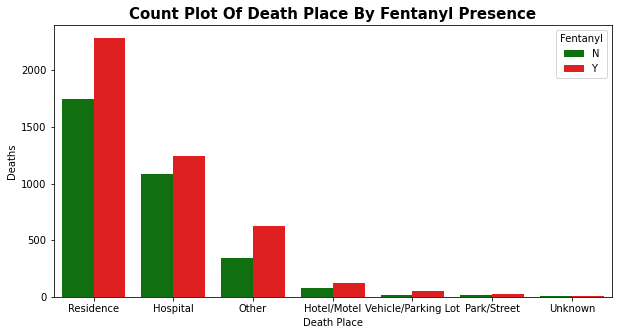

In [60]:
# visualise count plot of death_place column by fentanyl presence
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Death_Place', hue='Fentanyl', 
              order=df['Death_Place'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Death Place By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Death Place');

# save plot
plt.savefig('../plots/death_place_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The most common death place for fentanyl users is their residence.

#### Injury Place

In [61]:
# generate count and proportion of injury_place column
pd.DataFrame({'Injury Place': df['Injury_Place'].value_counts().index, 
              'Count': df['Injury_Place'].value_counts().values, 
              'Proportion': df['Injury_Place'].value_counts(normalize=True).values})

,Injury Place,Count,Proportion
0,Residence,5895,0.770991
1,Other,882,0.115354
2,Hotel/Motel,387,0.050615
3,Vehicle/Parking Lot,244,0.031912
4,Park/Street,150,0.019618
5,Unknown,78,0.010201
6,Hospital,10,0.001308


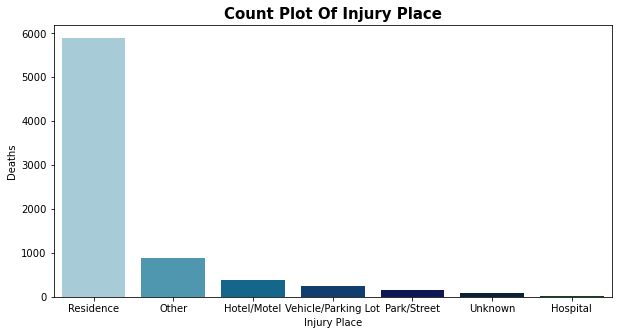

In [62]:
# visualise count plot of injury_place column
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Injury_Place', order=df['Injury_Place'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Injury Place', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Injury Place');

# save plot
plt.savefig('../plots/injury_place.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Most victims suffered from a drug overdose in their residence. Residence is the place of injury for 77.0% of victims.

In [63]:
# generate count and proportion of injury_place column by fentanyl presence
count = df.groupby(['Injury_Place', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Injury_Place', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Injury_Place        Fentanyl                   
Hospital            N             4    0.000523
                    Y             6    0.000785
Hotel/Motel         N           142    0.018572
                    Y           245    0.032043
Other               N           431    0.056369
                    Y           451    0.058985
Park/Street         N            54    0.007063
                    Y            96    0.012556
Residence           N          2535    0.331546
                    Y          3360    0.439445
Unknown             N            47    0.006147
                    Y            31    0.004054
Vehicle/Parking Lot N            75    0.009809
                    Y           169    0.022103

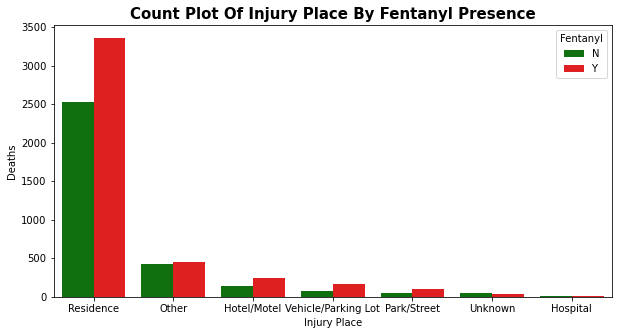

In [64]:
# visualise count plot of injury_place column by fentanyl presence
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Injury_Place', hue='Fentanyl', 
              order=df['Injury_Place'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Injury Place By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Injury Place');

# save plot
plt.savefig('../plots/injury_place_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The most common injury place for fentanyl users is their residence.

#### Covid Pandemic

In [65]:
# generate count and proportion of covid_pandemic column
pd.DataFrame({'Covid Pandemic': df['Covid_Pandemic'].value_counts().index, 
              'Count': df['Covid_Pandemic'].value_counts().values, 
              'Proportion': df['Covid_Pandemic'].value_counts(normalize=True).values})

,Covid Pandemic,Count,Proportion
0,N,6513,0.851818
1,Y,1133,0.148182


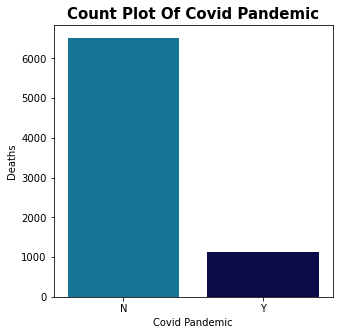

In [66]:
# visualise count plot of covid_pandemic column
plt.figure(figsize=(5, 5))
sns.countplot(data=df, x='Covid_Pandemic', order=df['Covid_Pandemic'].value_counts().index, palette='ocean_r')
plt.title('Count Plot Of Covid Pandemic', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Covid Pandemic');

# save plot
plt.savefig('../plots/covid_pandemic.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Given that the dataset contains deaths from 2012 to 2020, it is not surprising to see that there are more deaths that happened before the declaration of Covid-19 as a pandemic as compared to after. 85.1% of deaths happened before the declaration, which is over a period of 8 years and 2 months, and 14.8% of deaths happened after the declaration, which is over a period of 10 months.

In [67]:
# generate count and proportion of covid_pandemic column by fentanyl presence
count = df.groupby(['Covid_Pandemic', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Covid_Pandemic', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Covid_Pandemic Fentanyl                   
N              N          3105    0.406095
               Y          3408    0.445723
Y              N           183    0.023934
               Y           950    0.124248

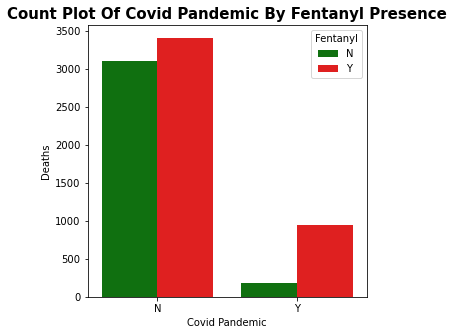

In [68]:
# visualise count plot of covid_pandemic column by fentanyl presence
plt.figure(figsize=(5, 5))
sns.countplot(data=df, x='Covid_Pandemic', hue='Fentanyl', 
              order=df['Covid_Pandemic'].value_counts().index, palette=['green', 'red'])
plt.title('Count Plot Of Covid Pandemic By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Covid Pandemic');

# save plot
plt.savefig('../plots/covid_pandemic_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Before Covid-19 was declared a pandemic, there were slightly more fentanyl deaths than non-fentanyl deaths. However, after Covid-19 was declared a pandemic, there were significantly more fentanyl deaths than non-fentanyl deaths. This can be explained by a combination of two possible factors: the rise in interest in fentanyl over time that has popularised its use coupled with the effect that the pandemic has in accelerating its adoption.

### Numerical Feature Visualisations

#### Age

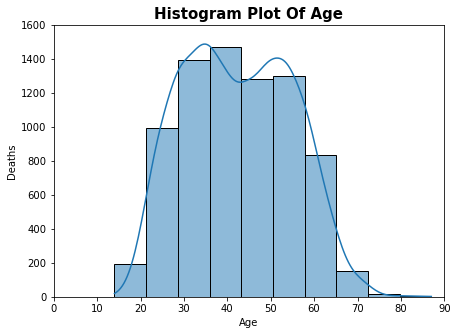

In [69]:
# visualise histogram plot of age column
plt.figure(figsize=(7, 5))
sns.histplot(data=df['Age'], bins=10, kde=True)
plt.title('Histogram Plot Of Age', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Age')
plt.ylim(0, 1600)
plt.xlim(0, 90);

# save plot
plt.savefig('../plots/age.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The distribution of age appears to be normal and symmetrical with no skew or extreme outliers. Most deaths happened around 40-50 years.

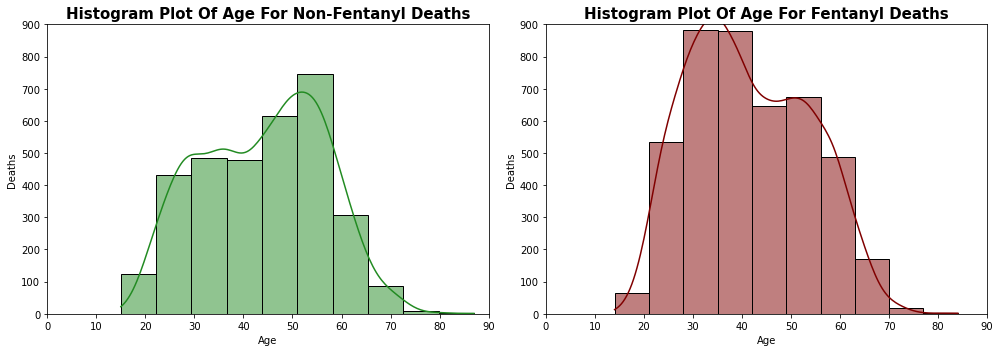

In [70]:
# visualise histogram plot of age column for non-fentanyl deaths and fentanyl deaths
plt.figure(figsize=(14, 5))

plt.subplot(1, 2, 1)
sns.histplot(data=df[df['Fentanyl'] == 'N']['Age'], bins=10, kde=True, color='forestgreen')
plt.title('Histogram Plot Of Age For Non-Fentanyl Deaths', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Age')
plt.ylim(0, 900)
plt.xlim(0, 90)

plt.subplot(1, 2, 2)
sns.histplot(data=df[df['Fentanyl'] == 'Y']['Age'], bins=10, kde=True, color='maroon')
plt.title('Histogram Plot Of Age For Fentanyl Deaths', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Age')
plt.ylim(0, 900)
plt.xlim(0, 90)

plt.tight_layout();

# save plot
plt.savefig('../plots/age_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** In non-fentanyl deaths, the distribution of age is asymmetrical and has a slight negative skew, with the peak number of deaths at around 50-60 years. In fentanyl deaths, the distribution of age is asymmetrical and has a slight positive skew, with the peak number of deaths at around 30-40 years. It appears that fentanyl users tend to have a shorter life expectancy than non-fentanyl users.

#### Number Of Drugs

In [71]:
# generate count and proportion of num_drugs column
pd.DataFrame({'Number Of Drugs': df['Num_Drugs'].value_counts().index, 
              'Count': df['Num_Drugs'].value_counts().values, 
              'Proportion': df['Num_Drugs'].value_counts(normalize=True).values})

,Number Of Drugs,Count,Proportion
0,2,2047,0.267722
1,3,1742,0.227832
2,1,1664,0.217630
3,4,1042,0.136280
4,5,617,0.080696
5,6,294,0.038451
6,7,140,0.018310
7,8,60,0.007847
8,9,27,0.003531
9,10,8,0.001046


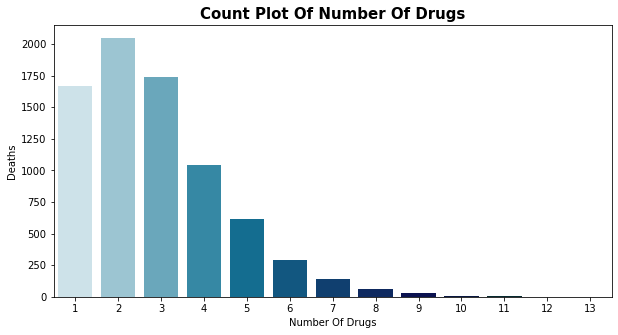

In [72]:
# visualise count plot of num_drugs column
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Num_Drugs', palette='ocean_r')
plt.title('Count Plot Of Number Of Drugs', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Number Of Drugs');

# save plot
plt.savefig('../plots/num_drugs.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Majority of victims died of an overdose by having more than one drug in their system as compared to minority of victims with just one drug in their system. Poly drug use accounts for 78.2% of deaths while single drug use accounts for 21.7% of deaths. Among poly drug deaths, the most common number of drugs in victims is two. Of note, deaths arising from victims who had two or three drugs were more frequent than victims who had one drug alone.

In [73]:
# generate count and proportion of num_drugs column by fentanyl presence
count = df.groupby(['Num_Drugs', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Num_Drugs', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Num_Drugs Fentanyl                   
1         N          1149    0.150275
          Y           515    0.067355
2         N           951    0.124379
          Y          1096    0.143343
3         N           577    0.075464
          Y          1165    0.152367
4         N           297    0.038844
          Y           745    0.097437
5         N           177    0.023149
          Y           440    0.057546
6         N            74    0.009678
          Y           220    0.028773
7         N            34    0.004447
          Y           106    0.013863
8         N            19    0.002485
          Y            41    0.005362
9         N             6    0.000785
          Y            21    0.002747
10        N             1    0.000131
          Y             7    0.000916
11        N             1    0.000131
          Y             2    0.000262
12        N             1    0.000131
13        N             1    0.000131

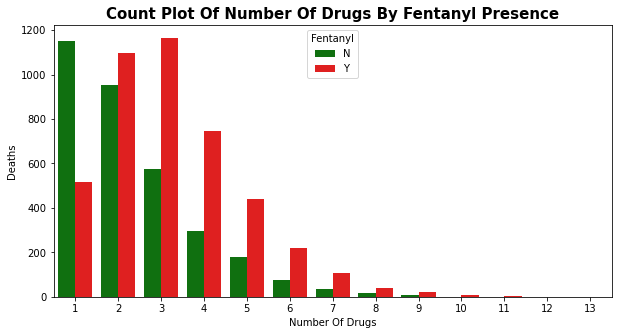

In [74]:
# visualise count plot of num_drugs column by fentanyl presence
plt.figure(figsize=(10, 5))
sns.countplot(data=df, x='Num_Drugs', hue='Fentanyl', palette=['green', 'red'])
plt.title('Count Plot Of Number Of Drugs By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Number Of Drugs');

# save plot
plt.savefig('../plots/num_drugs_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** In deaths that did not involve fentanyl, the highest number of deaths is seen among single drug users. In deaths that involved fentanyl, the highest number of deaths is seen among triple drug users, followed by double drug users, and then single drug users. There are more fentanyl deaths where the victims have two or three drugs in their system than victims who have just one drug alone in their system. This suggests than victims who died from fentanyl would more often have mixed fentanyl with one or two drugs than have taken fentanyl alone.

#### Number Of Conditions

In [75]:
# generate count and proportion of num_conditions column
pd.DataFrame({'Number Of Conditions': df['Num_Conditions'].value_counts().index, 
              'Count': df['Num_Conditions'].value_counts().values, 
              'Proportion': df['Num_Conditions'].value_counts(normalize=True).values})

,Number Of Conditions,Count,Proportion
0,0,7054,0.922574
1,1,359,0.046953
2,2,210,0.027465
3,3,19,0.002485
4,4,4,0.000523


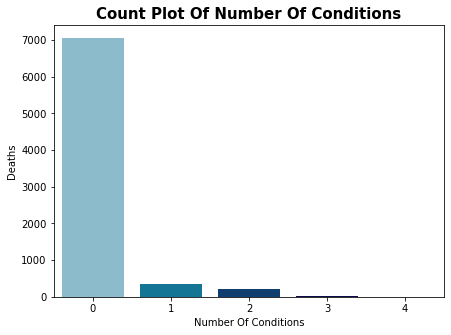

In [76]:
# visualise count plot of num_conditions column
plt.figure(figsize=(7, 5))
sns.countplot(data=df, x='Num_Conditions', palette='ocean_r')
plt.title('Count Plot Of Number Of Conditions', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Number Of Conditions');

# save plot
plt.savefig('../plots/num_conditions.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Most victims have no pre-existing medical conditions. 0 condition accounts for 92.2% of deaths.

In [77]:
# generate count and proportion of num_conditions column by fentanyl presence
count = df.groupby(['Num_Conditions', 'Fentanyl']).count()['Date']
proportion = df.groupby(['Num_Conditions', 'Fentanyl']).count()['Date'].transform(lambda x: x/x.sum())
dataframe = pd.concat([count, proportion], axis=1)
dataframe.columns = ['Count', 'Proportion']
dataframe

Count  Proportion
Num_Conditions Fentanyl                   
0              N          3017    0.394585
               Y          4037    0.527988
1              N           157    0.020534
               Y           202    0.026419
2              N            98    0.012817
               Y           112    0.014648
3              N            13    0.001700
               Y             6    0.000785
4              N             3    0.000392
               Y             1    0.000131

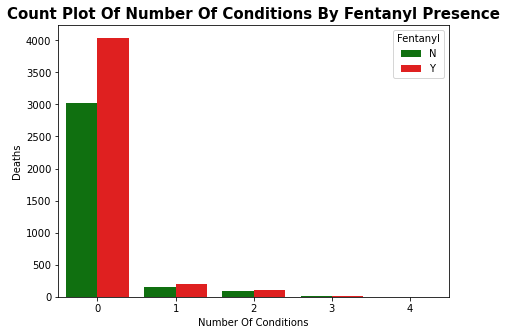

In [78]:
# visualise count plot of num_conditions column by fentanyl presence
plt.figure(figsize=(7, 5))
sns.countplot(data=df, x='Num_Conditions', hue='Fentanyl', palette=['green', 'red'])
plt.title('Count Plot Of Number Of Conditions By Fentanyl Presence', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Number Of Conditions');

# save plot
plt.savefig('../plots/num_conditions_by_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Most fentanyl users have no pre-existing medical conditions.

### Categorical Feature-Categorical Feature Visualisations

#### Sex Vs Race (Count Of Each Sex By Each Race)

In [79]:
# generate pivot table of sex column and race column
pt = df.pivot_table(values='Date', index='Sex', columns='Race', aggfunc='count')
pt

Race,Asian,Black,Hispanic,Rest,White
Sex,,,,,
Female,14,183,162,8,1583
Male,32,586,809,48,4221


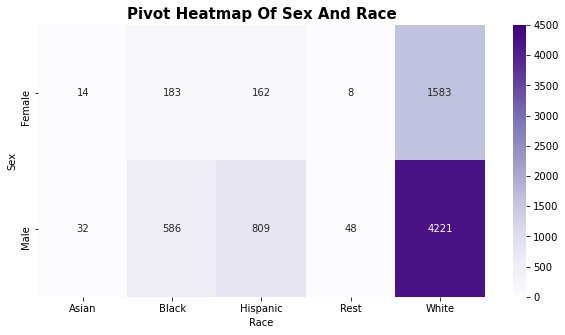

In [80]:
# visualise pivot heatmap of sex column and race column
plt.figure(figsize=(10, 5))
plt.title('Pivot Heatmap Of Sex And Race', fontweight='bold', fontsize=15)
sns.heatmap(pt, annot=True, annot_kws={'size': 10}, fmt='d', cmap='Purples', vmin=0, vmax=4500);

# save plot
plt.savefig('../plots/sex_vs_race.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The most common demographic profile is that of a White male. This is followed by a White female, a Hispanic male, and a Black male.

### Numerical Feature-Categorical Feature Visualisations

#### Age Vs Sex (Mean Age By Sex)

In [81]:
# generate mean age by sex
pd.DataFrame({'Sex': df.groupby('Sex').mean()['Age'].index, 
              'Mean Age': df.groupby('Sex').mean()['Age'].values})

,Sex,Mean Age
0,Female,42.851282
1,Male,42.335499


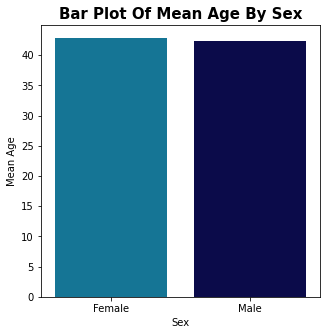

In [82]:
# visualise bar plot of mean age by sex
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Age', x='Sex', ci=None, order=['Female', 'Male'], palette='ocean_r')
plt.title('Bar Plot Of Mean Age By Sex', fontweight='bold', fontsize=15)
plt.ylabel('Mean Age')
plt.xlabel('Sex');

# save plot
plt.savefig('../plots/age_vs_sex.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean age of females is higher than that of males.

#### Age Vs Race (Mean Age By Race)

In [83]:
# generate mean age by race
pd.DataFrame({'Race': df.groupby('Race').mean()['Age'].sort_values(ascending=False).index, 
              'Mean Age': df.groupby('Race').mean()['Age'].sort_values(ascending=False).values})

,Race,Mean Age
0,Black,46.481144
1,Hispanic,42.354274
2,White,42.051172
3,Rest,38.375000
4,Asian,35.195652


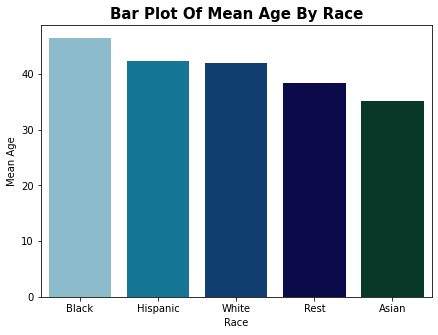

In [84]:
# visualise bar plot of mean age by race
plt.figure(figsize=(7, 5))
sns.barplot(data=df, y='Age', x='Race', ci=None, 
            order=df.groupby('Race').mean()['Age'].sort_values(ascending=False).index, palette='ocean_r')
plt.title('Bar Plot Of Mean Age By Race', fontweight='bold', fontsize=15)
plt.ylabel('Mean Age')
plt.xlabel('Race');

# save plot
plt.savefig('../plots/age_vs_race.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Among all the races, Blacks have the highest mean age while Asians have the lowest mean age.

#### Number Of Drugs Vs Sex (Mean Number Of Drugs By Sex)

In [85]:
# generate mean number of drugs by sex
pd.DataFrame({'Sex': df.groupby('Sex').mean()['Num_Drugs'].index, 
              'Mean Number Of Drugs': df.groupby('Sex').mean()['Num_Drugs'].values})

,Sex,Mean Number Of Drugs
0,Female,3.205128
1,Male,2.737360


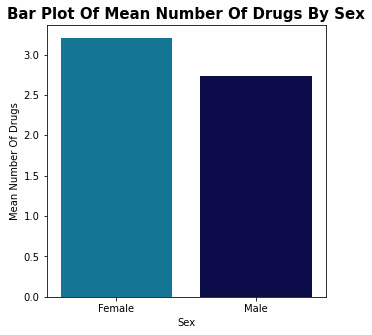

In [86]:
# visualise bar plot of mean number of drugs by sex
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Num_Drugs', x='Sex', ci=None, order=['Female', 'Male'], palette='ocean_r')
plt.title('Bar Plot Of Mean Number Of Drugs By Sex', fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Drugs')
plt.xlabel('Sex');

# save plot
plt.savefig('../plots/num_drugs_vs_sex.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean number of drugs in females is higher than that of males.

#### Number Of Drugs Vs Race (Mean Number Of Drugs By Race)

In [87]:
# generate mean number of drugs by race
pd.DataFrame({'Race': df.groupby('Race').mean()['Num_Drugs'].sort_values(ascending=False).index, 
              'Mean Number Of Drugs': df.groupby('Race').mean()['Num_Drugs'].sort_values(ascending=False).values})

,Race,Mean Number Of Drugs
0,Asian,3.108696
1,White,2.912302
2,Black,2.684005
3,Hispanic,2.672503
4,Rest,2.446429


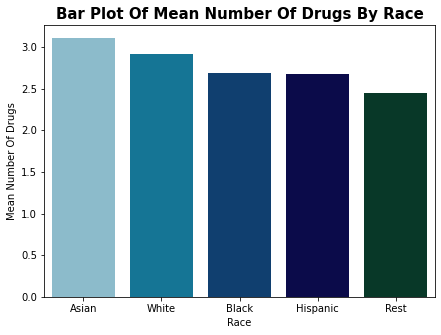

In [88]:
# visualise bar plot of mean number of drugs by race
plt.figure(figsize=(7, 5))
sns.barplot(data=df, y='Num_Drugs', x='Race', ci=None, 
            order=df.groupby('Race').mean()['Num_Drugs'].sort_values(ascending=False).index, palette='ocean_r')
plt.title('Bar Plot Of Mean Number Of Drugs By Race', fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Drugs')
plt.xlabel('Race');

# save plot
plt.savefig('../plots/num_drugs_vs_race.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Among all the races, Asians have the highest mean number of drugs in them while the Rest have the lowest mean number of drugs in them.

#### Number Of Conditions Vs Sex (Mean Number Of Conditions By Sex)

In [89]:
# generate mean number of conditions by sex
pd.DataFrame({'Sex': df.groupby('Sex').mean()['Num_Conditions'].index, 
              'Mean Number Of Conditions': df.groupby('Sex').mean()['Num_Conditions'].values})

,Sex,Mean Number Of Conditions
0,Female,0.087692
1,Male,0.119558


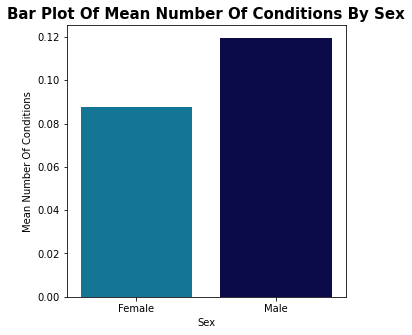

In [90]:
# visualise bar plot of mean number of conditions by sex
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Num_Conditions', x='Sex', ci=None, order=['Female', 'Male'], palette='ocean_r')
plt.title('Bar Plot Of Mean Number Of Conditions By Sex', fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Conditions')
plt.xlabel('Sex');

# save plot
plt.savefig('../plots/num_conditions_vs_sex.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean number of pre-existing medical conditions that females have is lower than that of males.

#### Number Of Conditions Vs Race (Mean Number Of Conditions By Race)

In [91]:
# generate mean number of conditions by race
pd.DataFrame({'Race': df.groupby('Race').mean()['Num_Conditions'].sort_values(ascending=False).index, 
              'Mean Number Of Conditions': df.groupby('Race').mean()['Num_Conditions'].sort_values(ascending=False).values})

,Race,Mean Number Of Conditions
0,Black,0.187256
1,Rest,0.125000
2,Hispanic,0.102987
3,White,0.102860
4,Asian,0.086957


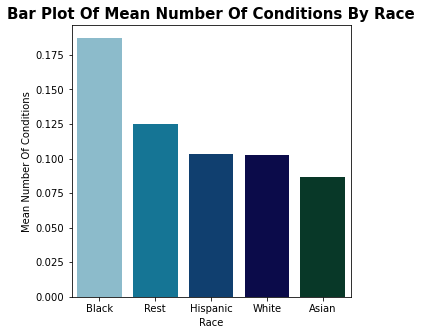

In [92]:
# visualise bar plot of mean number of conditions by race
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Num_Conditions', x='Race', ci=None, 
            order=df.groupby('Race').mean()['Num_Conditions'].sort_values(ascending=False).index, palette='ocean_r')
plt.title('Bar Plot Of Mean Number Of Conditions By Race', fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Conditions')
plt.xlabel('Race');

# save plot
plt.savefig('../plots/num_conditions_vs_race.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Among all the races, Blacks have the highest mean number of pre-existing medical conditions while Asians have the lowest mean number of pre-existing medical conditions.

### Numerical Feature-Numerical Feature Visualisations

#### Age Vs Number Of Drugs (Mean Age By Number Of Drugs)

In [93]:
# generate mean age by number of drugs
pd.DataFrame({'Number Of Drugs': df.groupby('Num_Drugs').mean()['Age'].index, 
              'Mean Age': df.groupby('Num_Drugs').mean()['Age'].values})

,Number Of Drugs,Mean Age
0,1,40.808293
1,2,41.929165
2,3,42.814007
3,4,43.758157
4,5,43.975689
5,6,43.081633
6,7,44.871429
7,8,48.500000
8,9,44.074074
9,10,49.500000


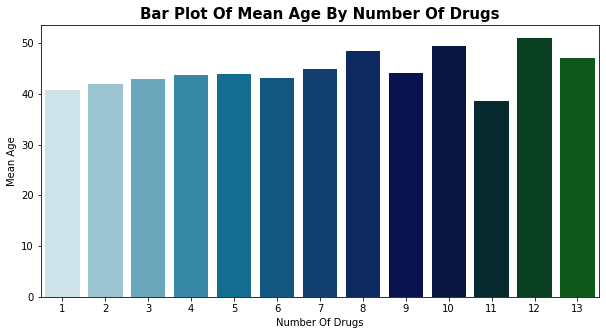

In [94]:
# visualise bar plot of mean age by number of drugs
plt.figure(figsize=(10, 5))
sns.barplot(data=df, y='Age', x='Num_Drugs', ci=None, palette='ocean_r')
plt.title('Bar Plot Of Mean Age By Number Of Drugs', fontweight='bold', fontsize=15)
plt.ylabel('Mean Age')
plt.xlabel('Number Of Drugs');

# save plot
plt.savefig('../plots/age_vs_num_drugs.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** As the number of drugs in victims increases, the mean age of victims increases. This can probably be explained by the fact that older folks could be on more medications than younger folks so in the event of an overdose senior residents would be found with more drugs than junior residents.

#### Age Vs Number Of Conditions (Mean Age By Number Of Conditions)

In [95]:
# generate mean age by number of conditions
pd.DataFrame({'Number Of Conditions': df.groupby('Num_Conditions').mean()['Age'].index, 
              'Mean Age': df.groupby('Num_Conditions').mean()['Age'].values})

,Number Of Conditions,Mean Age
0,0,41.950525
1,1,45.802228
2,2,52.780952
3,3,54.578947
4,4,55.000000


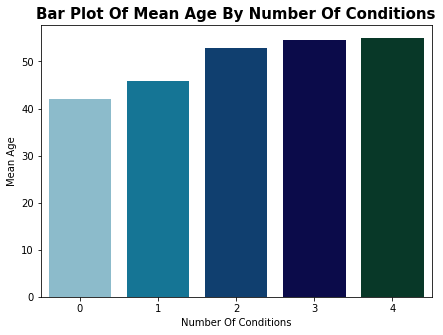

In [96]:
# visualise bar plot of mean age by number of conditions
plt.figure(figsize=(7, 5))
sns.barplot(data=df, y='Age', x='Num_Conditions', ci=None, palette='ocean_r')
plt.title('Bar Plot Of Mean Age By Number Of Conditions', fontweight='bold', fontsize=15)
plt.ylabel('Mean Age')
plt.xlabel('Number Of Conditions');

# save plot
plt.savefig('../plots/age_vs_num_conditions.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** As the number of pre-existing medical conditions that victims have increases, the mean age of victims increases. This makes sense as older persons would naturally have more pre-existing medical conditions than younger persons due to the deteriorating effects of age on health.

### Categorical Feature-Target Visualisations

#### Fentanyl Vs Rest Of The Drugs

In [97]:
# make a dataframe of the death count from fentanyl and rest of the drugs
all_drugs = list(df.loc[:, 'Fentanyl': 'Other_Drug'].columns) + ['Other_Opioid']

drug_name = []
drug_count = []

for x in all_drugs:
    drug_name.append(x)
    drug_count.append(len(df[df[x] == 'Y']))

drug = pd.DataFrame({'Drug': drug_name, 'Deaths': drug_count}).sort_values('Deaths', ascending=False)

drug

,Drug,Deaths
0,Fentanyl,4358
8,Heroin,3177
13,Cocaine,2524
12,Ethanol,2019
16,Any_Benzodiazepine,1937
6,Oxycodone,800
1,Any_Fentanyl_Analogue,713
3,Methadone,693
18,Other_Drug,568
9,Morphine_Not_Heroin,352


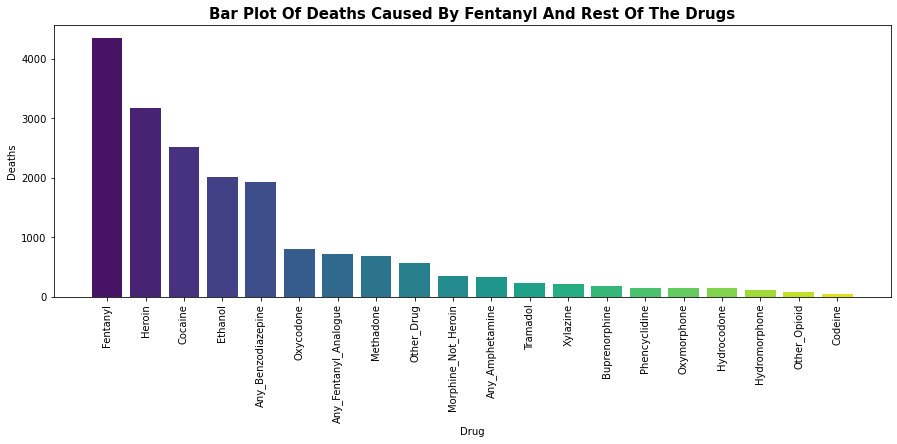

In [98]:
# visualise bar plot of deaths caused by fentanyl and rest of the drugs
plt.figure(figsize=(15, 5))
plt.bar(x=drug['Drug'], height=drug['Deaths'], color=sns.color_palette('viridis', len(drug['Drug'])))
plt.title('Bar Plot Of Deaths Caused By Fentanyl And Rest Of The Drugs', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Drug')
plt.xticks(rotation=90);

# save plot
plt.savefig('../plots/fentanyl_vs_rest_of_the_drugs.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** Fentanyl is responsible for the most number of deaths.

#### Fentanyl Alone Vs Fentanyl-Drug Combinations

In [99]:
# make a dataframe of the death count from fentanyl alone
fentanyl_alone = pd.DataFrame({'Fentanyl': ['Fentanyl Alone'], 
                               'Deaths': [len(df[(df['Fentanyl'] == 'Y') & (df['Num_Drugs'] == 1)])]})
fentanyl_alone

,Fentanyl,Deaths
0,Fentanyl Alone,515


In [100]:
# make a dataframe of the death count from fentanyl-drug combinations
combi_drugs = df.loc[:, 'Buprenorphine': 'Other_Drug'].columns

fentanyl_drug_name = []
fentanyl_drug_count = []

for x in combi_drugs:
    fentanyl_drug_name.append('Fentanyl And {}'.format(x))
    fentanyl_drug_count.append(df[df['Fentanyl'] == 'Y'][x].value_counts()['Y'])

fentanyl_drug = pd.DataFrame({'Fentanyl': fentanyl_drug_name, 
                              'Deaths': fentanyl_drug_count}).sort_values('Deaths', ascending=False)
fentanyl_drug

,Fentanyl,Deaths
6,Fentanyl And Heroin,1644
11,Fentanyl And Cocaine,1555
10,Fentanyl And Ethanol,1145
14,Fentanyl And Any_Benzodiazepine,975
1,Fentanyl And Methadone,263
4,Fentanyl And Oxycodone,244
16,Fentanyl And Other_Drug,242
15,Fentanyl And Any_Amphetamine,216
12,Fentanyl And Xylazine,209
7,Fentanyl And Morphine_Not_Heroin,185


In [101]:
# concatenate both dataframes
fentanyl_concat = pd.concat([fentanyl_alone, fentanyl_drug], axis=0)
fentanyl_concat

,Fentanyl,Deaths
0,Fentanyl Alone,515
6,Fentanyl And Heroin,1644
11,Fentanyl And Cocaine,1555
10,Fentanyl And Ethanol,1145
14,Fentanyl And Any_Benzodiazepine,975
1,Fentanyl And Methadone,263
4,Fentanyl And Oxycodone,244
16,Fentanyl And Other_Drug,242
15,Fentanyl And Any_Amphetamine,216
12,Fentanyl And Xylazine,209


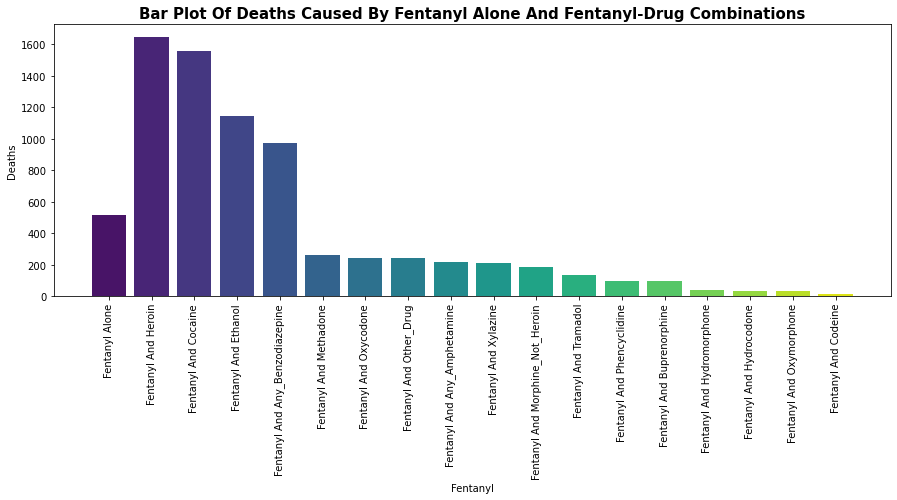

In [102]:
# visualise bar plot of deaths caused by fentanyl alone and fentanyl-drug combinations
plt.figure(figsize=(15, 5))
plt.bar(x=fentanyl_concat['Fentanyl'], height=fentanyl_concat['Deaths'], 
        color=sns.color_palette('viridis', len(fentanyl_concat['Fentanyl'])))
plt.title('Bar Plot Of Deaths Caused By Fentanyl Alone And Fentanyl-Drug Combinations', fontweight='bold', fontsize=15)
plt.ylabel('Deaths')
plt.xlabel('Fentanyl')
plt.xticks(rotation=90);

# save plot
plt.savefig('../plots/fentanyl_alone_vs_fentanyl_drug_combinations.png', 
            dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** As a baseline, fentanyl alone has been responsible for 515 deaths. As for fentanyl-drug combinations, the most lethal duo is a fentanyl-heroin combination which has been responsible for 1644 deaths. The following drug combinations with fentanyl - heroin, cocaine, ethanol, or any benzodiazepine - have each resulted in more deaths than fentanyl alone. Fentanyl-heroin is responsible for the most number of deaths, followed by fentanyl-cocaine, fentanyl-ethanol, and fentanyl-any benzodiazepine. This alludes to the possibility that certain fentanyl-drug combinations have a combined toxicity that is much greater than that of fentanyl alone.

### Numerical Feature-Target Visualisations

#### Age Vs Fentanyl Presence (Mean Age Of Non-Fentanyl Deaths And Fentanyl Deaths)

In [103]:
# generate mean age of non-fentanyl deaths and fentanyl deaths
pd.DataFrame({'Fentanyl': df.groupby('Fentanyl').mean()['Age'].index, 
              'Mean Age': df.groupby('Fentanyl').mean()['Age'].values})

,Fentanyl,Mean Age
0,N,43.935219
1,Y,41.359339


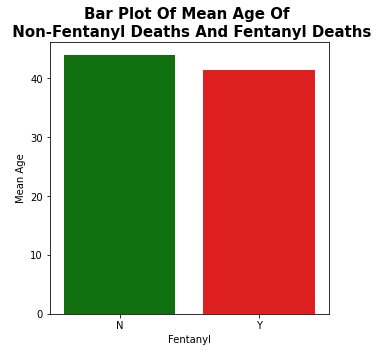

In [104]:
# visualise bar plot of mean age of non-fentanyl deaths and fentanyl deaths
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Age', x='Fentanyl', ci=None, palette=['green', 'red'])
plt.title('Bar Plot Of Mean Age Of \n Non-Fentanyl Deaths And Fentanyl Deaths', fontweight='bold', fontsize=15)
plt.ylabel('Mean Age')
plt.xlabel('Fentanyl');

# save plot
plt.savefig('../plots/age_vs_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean age of fentanyl users is lower than that of non-fentanyl users. Fentanyl users lived shorter lives on average than non-fentanyl users.

#### Number Of Drugs Vs Fentanyl Presence (Mean Number Of Drugs In Non-Fentanyl Deaths And Fentanyl Deaths)

In [105]:
# generate mean number of drugs in non-fentanyl deaths and fentanyl deaths
pd.DataFrame({'Fentanyl': df.groupby('Fentanyl').mean()['Num_Drugs'].index, 
              'Mean Number Of Drugs': df.groupby('Fentanyl').mean()['Num_Drugs'].values})

,Fentanyl,Mean Number Of Drugs
0,N,2.368917
1,Y,3.224644


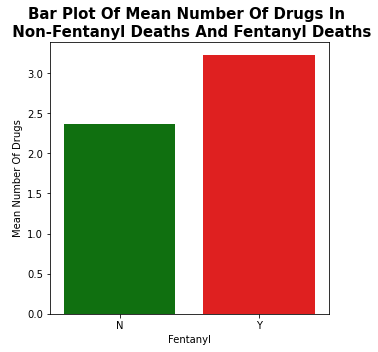

In [106]:
# visualise bar plot of mean number of drugs in non-fentanyl deaths and fentanyl deaths
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Num_Drugs', x='Fentanyl', ci=None, palette=['green', 'red'])
plt.title('Bar Plot Of Mean Number Of Drugs In \n Non-Fentanyl Deaths And Fentanyl Deaths', 
          fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Drugs')
plt.xlabel('Fentanyl');

# save plot
plt.savefig('../plots/num_drugs_vs_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean number of drugs in fentanyl users is higher than that of non-fentanyl users. Fentanyl users overdosed on more drugs on average than non-fentanyl users.

#### Number Of Conditions Vs Fentanyl Presence (Mean Number Of Conditions In Non-Fentanyl Deaths And Fentanyl Deaths)

In [107]:
# generate mean number of conditions in non-fentanyl deaths and fentanyl deaths
pd.DataFrame({'Fentanyl': df.groupby('Fentanyl').mean()['Num_Conditions'].index, 
              'Mean Number Of Conditions': df.groupby('Fentanyl').mean()['Num_Conditions'].values})

,Fentanyl,Mean Number Of Conditions
0,N,0.122871
1,Y,0.102799


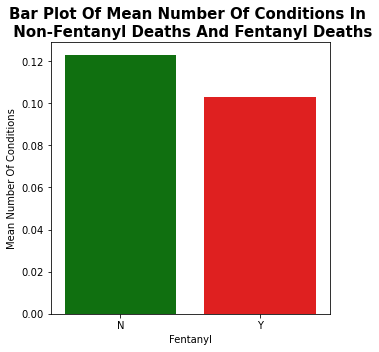

In [108]:
# visualise bar plot of mean number of conditions in non-fentanyl deaths and fentanyl deaths
plt.figure(figsize=(5, 5))
sns.barplot(data=df, y='Num_Conditions', x='Fentanyl', ci=None, palette=['green', 'red'])
plt.title('Bar Plot Of Mean Number Of Conditions In \n Non-Fentanyl Deaths And Fentanyl Deaths', 
          fontweight='bold', fontsize=15)
plt.ylabel('Mean Number Of Conditions')
plt.xlabel('Fentanyl');

# save plot
plt.savefig('../plots/num_conditions_vs_fentanyl_presence.png', dpi='figure', bbox_inches='tight', facecolor=(1, 1, 1))

**Interpretation:** The mean number of pre-existing medical conditions that fentanyl users have is lower than that of non-fentanyl users. Fentanyl users had better health on average than non-fentanyl users.